# Deep Learning (STAT 4984) Final Project
#### Pranav Thiriveedhi
#### Computer Vision - Carvana Image Masking

Will be using a convolutional neural network type architecture. Will train and use image segmentation and output a pixel-wise mask of the image which will help us create a picture without the car, only the empty background mask, which will help us substitute the blank background with any background of choice. 

Importing necessary libraries


In [1]:
# Standard Python libraries
import numpy as np 
import pandas as pd 
import matplotlib.pyplot as plt
from zipfile import ZipFile 
import os

# Machine Learning related libraries
import tensorflow as tf
import keras.backend as K
from sklearn.model_selection import train_test_split


Preparing the Train Sets and Train Masks (what we will be working with)

In [2]:
print("Train set:   ", 
      len(os.listdir("/Users/pranavthiriveedhi/Downloads/carvana-image-masking-challenge/train")))
print("Train masks: ", 
      len(os.listdir("/Users/pranavthiriveedhi/Downloads/carvana-image-masking-challenge/train_masks")))

Train set:    5088
Train masks:  5088


Attaching an ID to each image of both the normal car photos and the masks

In [3]:
train_set = os.walk("/Users/pranavthiriveedhi/Downloads/carvana-image-masking-challenge/train")
train_masks = os.walk("/Users/pranavthiriveedhi/Downloads/carvana-image-masking-challenge/train_masks")

In [4]:
car_ids = []
paths = []
for directory_name,_, file_name in os.walk("/Users/pranavthiriveedhi/Downloads/carvana-image-masking-challenge/train"):
    for i in file_name:
        path = os.path.join(directory_name, i)    
        paths.append(path)
        
        car_id = i.split(".")[0]
        car_ids.append(car_id)

dt = {"ID": car_ids, "car_image_path": paths}
Carvana_DF = pd.DataFrame(data = dt)
Carvana_DF = Carvana_DF.set_index('ID')


In [5]:
car_ids = []
mask_paths = []
for directory_name,_, file_name in os.walk("/Users/pranavthiriveedhi/Downloads/carvana-image-masking-challenge/train_masks"):
    for i in file_name:
        path = os.path.join(directory_name, i)    
        mask_paths.append(path)
        
        car_id = i.split(".")[0]
        car_id = car_id.split("_mask")[0]
        car_ids.append(car_id)


d = {"ID": car_ids, "car_mask_path": mask_paths}
Masks_DF = pd.DataFrame(data = d)
Masks_DF = Masks_DF.set_index('ID')

In [6]:
Carvana_DF["car_mask_path"] = Masks_DF["car_mask_path"]

Final Table of IDs for each car image and it's corresponding mask

In [7]:
Carvana_DF

,car_image_path,car_mask_path
ID,,
bd8d5780ed04_07,/Users/pranavthiriveedhi/Downloads/carvana-ima...,/Users/pranavthiriveedhi/Downloads/carvana-ima...
6752de44b721_01,/Users/pranavthiriveedhi/Downloads/carvana-ima...,/Users/pranavthiriveedhi/Downloads/carvana-ima...
1390696b70b6_02,/Users/pranavthiriveedhi/Downloads/carvana-ima...,/Users/pranavthiriveedhi/Downloads/carvana-ima...
ce74dfdf123b_04,/Users/pranavthiriveedhi/Downloads/carvana-ima...,/Users/pranavthiriveedhi/Downloads/carvana-ima...
ce74dfdf123b_10,/Users/pranavthiriveedhi/Downloads/carvana-ima...,/Users/pranavthiriveedhi/Downloads/carvana-ima...
...,...,...
7251c8797749_09,/Users/pranavthiriveedhi/Downloads/carvana-ima...,/Users/pranavthiriveedhi/Downloads/carvana-ima...
717689f3e788_16,/Users/pranavthiriveedhi/Downloads/carvana-ima...,/Users/pranavthiriveedhi/Downloads/carvana-ima...
03a857ce842d_03,/Users/pranavthiriveedhi/Downloads/carvana-ima...,/Users/pranavthiriveedhi/Downloads/carvana-ima...


Normalizing the Images

In [8]:
img_size = [256,256]

In [9]:
def flip_image(car_image, mask_image):

    if tf.random.uniform(()) > 0.5:
        car_image = tf.image.flip_left_right(car_image)
        mask_image = tf.image.flip_left_right(mask_image)

    return car_image, mask_image

In [10]:
def preprocessing(car_image_path, car_mask_path):
    car_image = tf.io.read_file(car_image_path) 
    car_image = tf.image.decode_jpeg(car_image, channels=3)
    car_image = tf.image.resize(car_image, img_size)
    car_image = tf.cast(car_image, tf.float32) / 255.0
    
    mask_image = tf.io.read_file(car_mask_path)
    mask_image = tf.image.decode_jpeg(mask_image, channels=3)
    mask_image = tf.image.resize(mask_image, img_size)
    mask_image = mask_image[:,:,:1]    
    mask_image = tf.math.sign(mask_image)
    
    
    return car_image, mask_image


In [11]:
def create_dataset(Carvana_DF, train = False):
    if not train:
        ds = tf.data.Dataset.from_tensor_slices((Carvana_DF["car_image_path"].values, Carvana_DF["car_mask_path"].values))
        ds = ds.map(preprocessing, tf.data.AUTOTUNE)
    else:
        ds = tf.data.Dataset.from_tensor_slices((Carvana_DF["car_image_path"].values, Carvana_DF["car_mask_path"].values))
        ds = ds.map(preprocessing, tf.data.AUTOTUNE)
        ds = ds.map(flip_image, tf.data.AUTOTUNE)

    return ds

Splitting the data from the Carvana_DF data frame into a train data frame and a test data frame

In [12]:
train_df, valid_df = train_test_split(Carvana_DF, random_state=42, test_size=.25)
train = create_dataset(train_df, train = True)
valid = create_dataset(valid_df)

In [13]:
TRAIN_LENGTH = len(train_df)
BATCH_SIZE = 16
BUFFER_SIZE = 1000

In [14]:
train_dataset = train.cache().shuffle(BUFFER_SIZE).batch(BATCH_SIZE).repeat()
train_dataset = train_dataset.prefetch(buffer_size=tf.data.AUTOTUNE)
valid_dataset = valid.batch(BATCH_SIZE)

Function to display image of car and image of car mask side by side

In [15]:
def display(display_image):
    plt.figure(figsize=(15, 15))

    title = ['Input Image', 'True Mask', 'Predicted Mask']

    for iter in range(len(display_image)):
        plt.subplot(1, len(display_image), iter + 1)
        plt.title(title[iter])
        plt.imshow(tf.keras.preprocessing.image.array_to_img(display_image[iter]))
        plt.axis('off')
    plt.show()

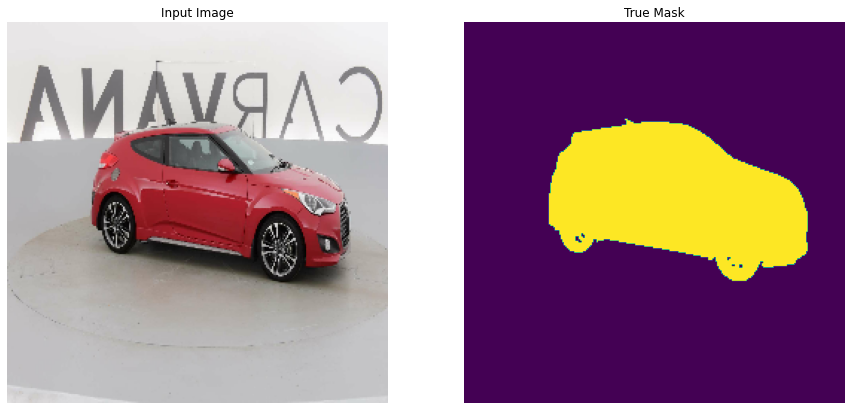

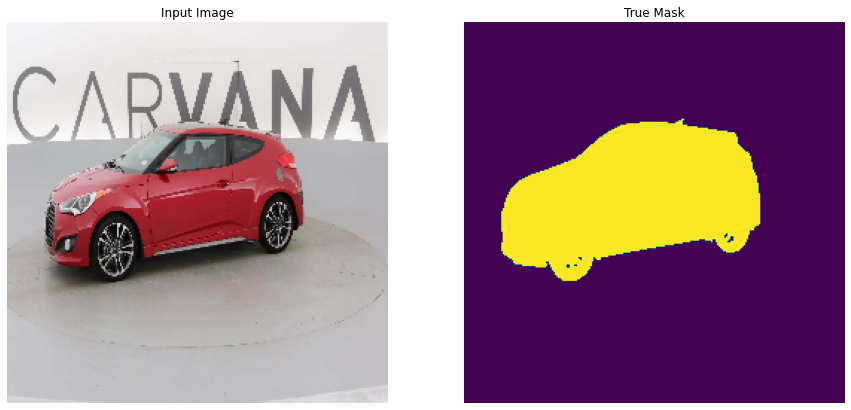

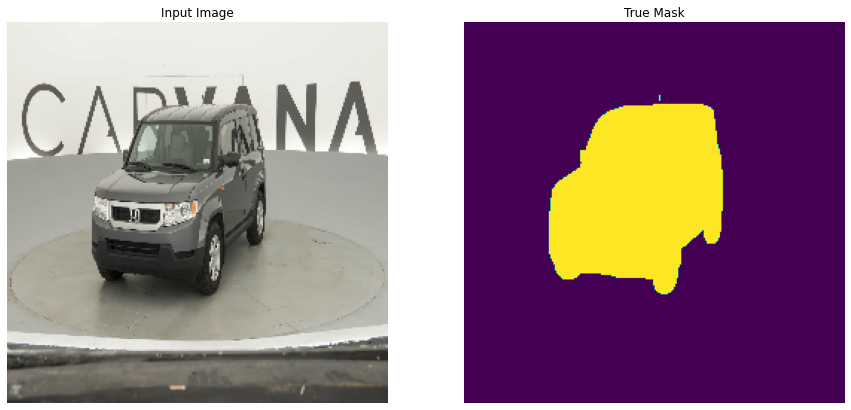

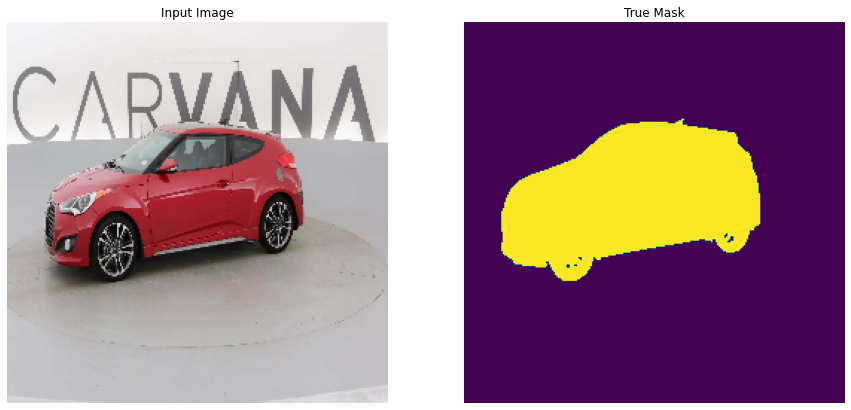

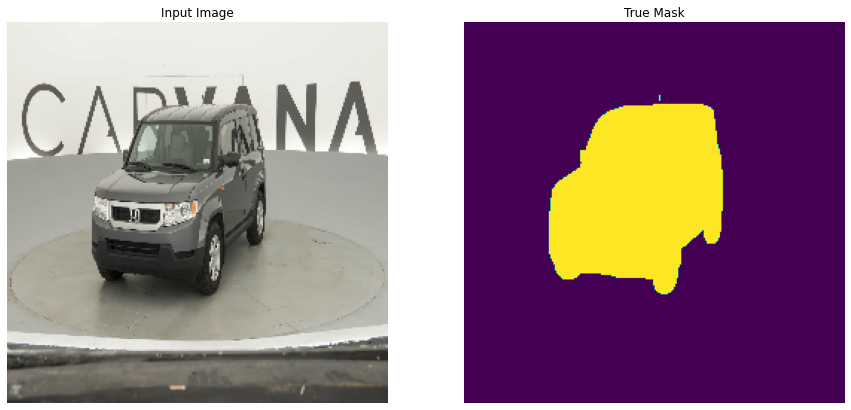

...

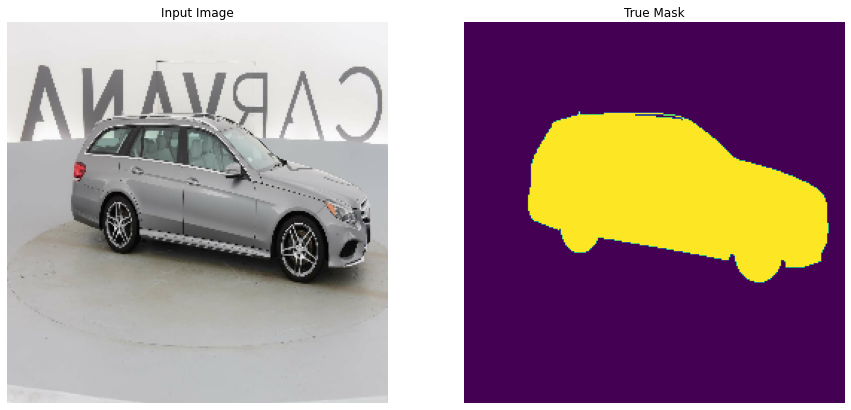

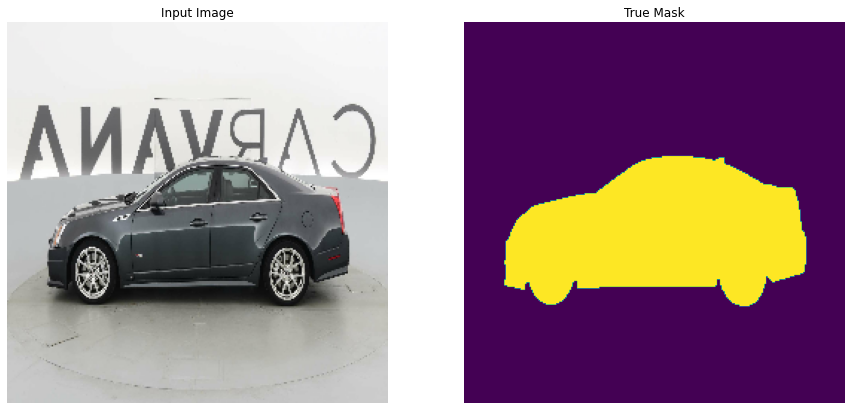

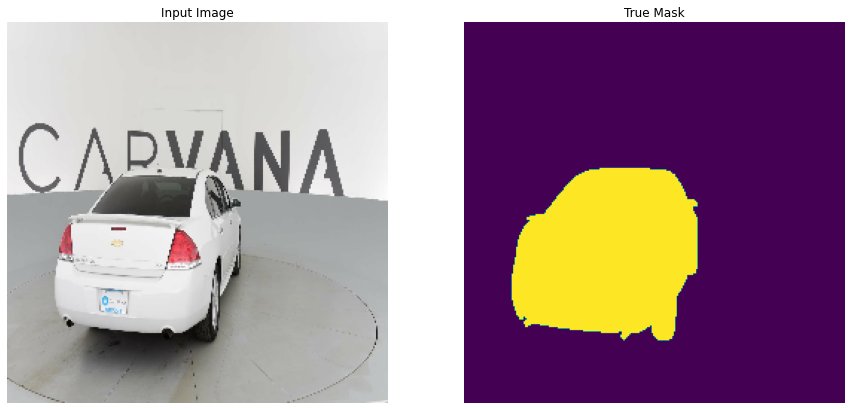

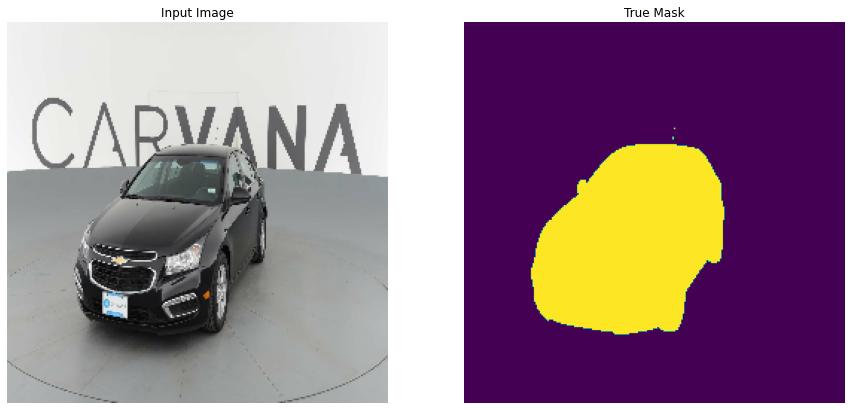

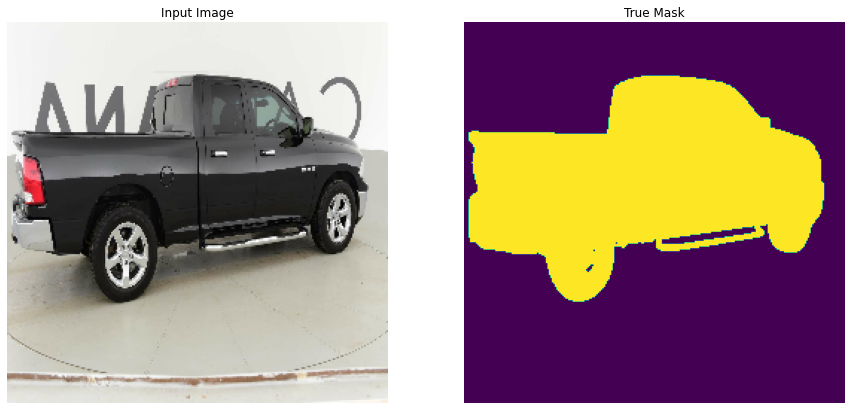

In [16]:
for iter in range(10):
   for image, mask in train.take(iter):
        input_image, true_mask = image, mask
        display([input_image, true_mask])

Creating the model (using U-net - image segmentation)

In [17]:
base_model = tf.keras.applications.MobileNetV2(input_shape=[256, 256, 3], include_top=False)

In [18]:
# Use the activations of these layers
layer_names = [
    'block_1_expand_relu',   # 64x64
    'block_3_expand_relu',   # 32x32
    'block_6_expand_relu',   # 16x16
    'block_13_expand_relu',  # 8x8
    'block_16_project',      # 4x4
]

In [19]:
base_model_outputs = [base_model.get_layer(name).output for name in layer_names]


In [20]:
down_stack = tf.keras.Model(inputs=base_model.input, outputs=base_model_outputs)
down_stack.trainable = False

In [21]:
def upsample(filters, size, norm_type='batchnorm', apply_dropout=False):
    initializer = tf.random_normal_initializer(0., 0.02)
    
    result = tf.keras.Sequential()
    result.add(
      tf.keras.layers.Conv2DTranspose(filters, size, strides=2,
                                      padding='same',
                                      kernel_initializer=initializer,
                                      use_bias=False))

    if norm_type.lower() == 'batchnorm':
        result.add(tf.keras.layers.BatchNormalization())
    elif norm_type.lower() == 'instancenorm':
        result.add(InstanceNormalization())

    if apply_dropout:
        result.add(tf.keras.layers.Dropout(0.5))

        result.add(tf.keras.layers.ReLU())

    return result


In [22]:
up_stack = [
    upsample(512, 3),  # 4x4 -> 8x8
    upsample(256, 3),  # 8x8 -> 16x16
    upsample(128, 3),  # 16x16 -> 32x32
    upsample(64, 3),   # 32x32 -> 64x64
]

In [23]:
def unet_model(output_channels):
    inputs = tf.keras.layers.Input(shape=[256, 256, 3])

    # Downsampling through the model
    skips = down_stack(inputs)
    x = skips[-1]
    skips = reversed(skips[:-1])

  # Upsampling and establishing the skip connections
    for up, skip in zip(up_stack, skips):
        x = up(x)
        concat = tf.keras.layers.Concatenate()
        x = concat([x, skip])

  # This is the last layer of the model
    last = tf.keras.layers.Conv2DTranspose(
      output_channels, 3, strides=2, activation='sigmoid',
      padding='same')  #64x64 -> 128x128

    x = last(x)

    return tf.keras.Model(inputs=inputs, outputs=x)

Training the model

In [24]:
def dice_coef(y_true, y_pred, smooth=1):
    intersection = K.sum(y_true * y_pred, axis=[1,2,3])
    union = K.sum(y_true, axis=[1,2,3]) + K.sum(y_pred, axis=[1,2,3])
    return K.mean( (2. * intersection + smooth) / (union + smooth), axis=0)

In [25]:
def dice_loss(in_gt, in_pred):
    return 1-dice_coef(in_gt, in_pred)

In [26]:
model = unet_model(1)

model.compile(optimizer='adam',
              loss = dice_loss,
              metrics=[dice_coef,'binary_accuracy'])


In [27]:
tf.keras.utils.plot_model(model, show_shapes=True)

You must install pydot (`pip install pydot`) and install graphviz (see instructions at https://graphviz.gitlab.io/download/) for plot_model/model_to_dot to work.


In [29]:
for images, masks in train_dataset.take(1):
    for image, mask in zip(images, masks):
        input_image = image
        true_mask = mask
        break

In [30]:
def visualize(display_image):
    plt.figure(figsize=(15, 15))
    title = ['Input Image', 'True Mask', 'Predicted Mask']
    for i in range(len(display_image)):
        plt.subplot(1, len(display_image), i+1)
        plt.title(title[i])
        plt.imshow(tf.keras.preprocessing.image.array_to_img(display_image[i]))
        plt.axis('off')
    plt.show()

In [33]:
def show_predictions(input_image, true_mask):
    predicted_mask = model.predict(input_image[tf.newaxis, ...])
    predicted_mask = predicted_mask.reshape(img_size[0],img_size[1],1)
    visualize([input_image, true_mask, predicted_mask])

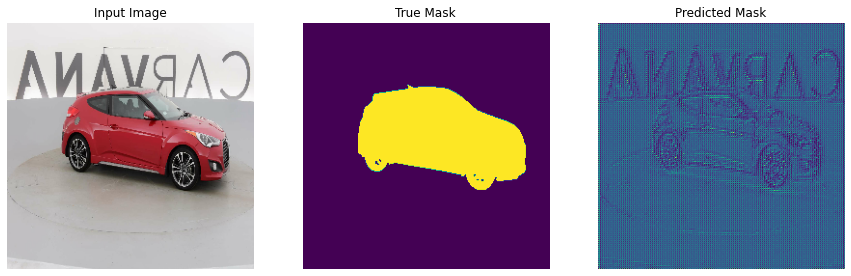

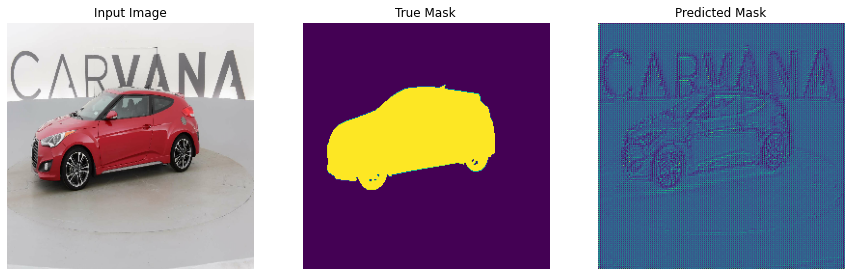

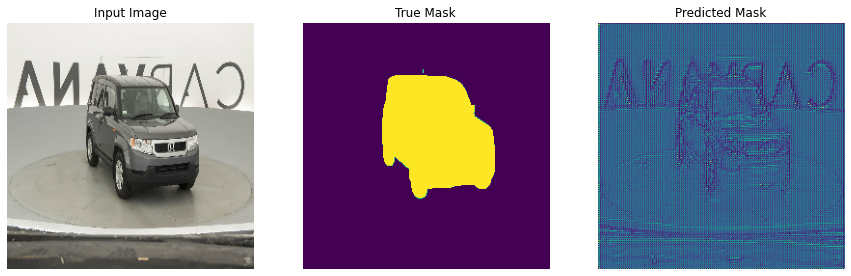

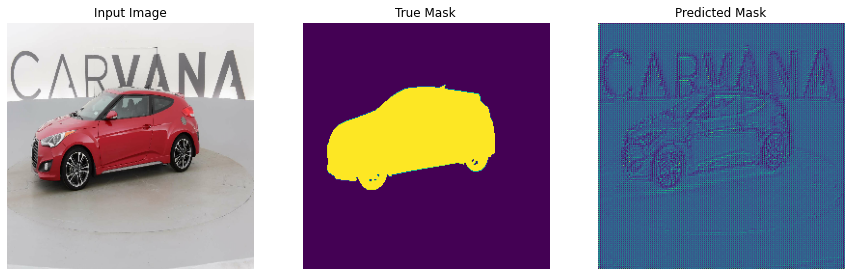

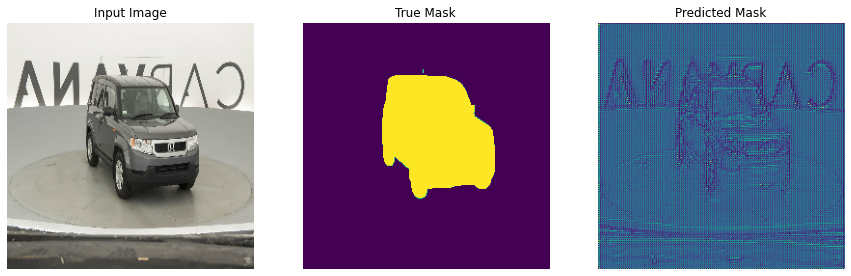

...

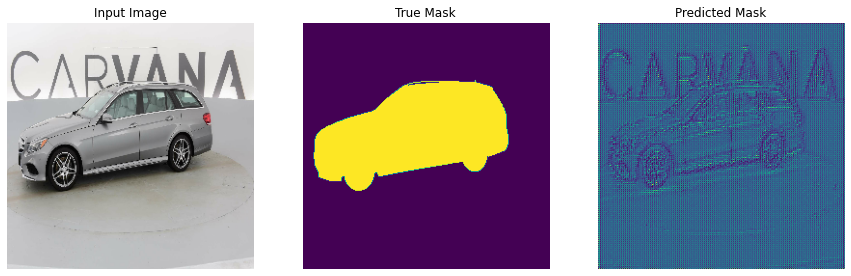

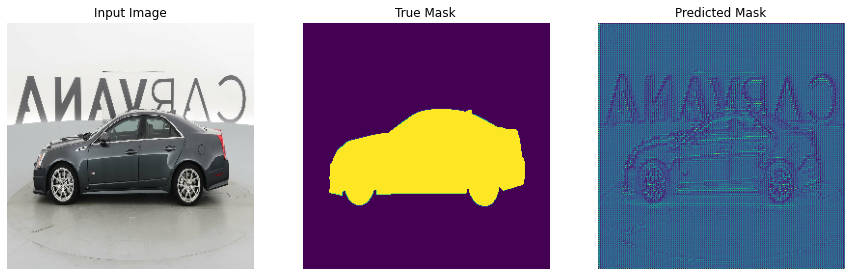

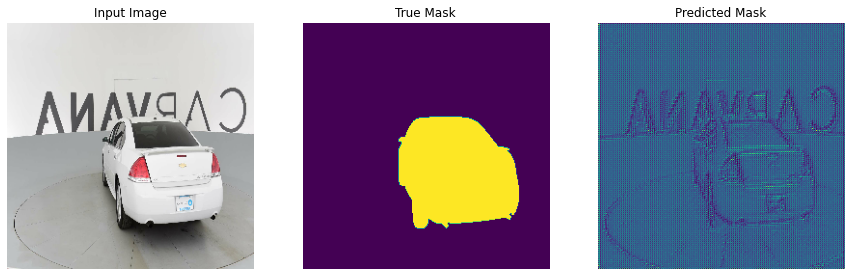

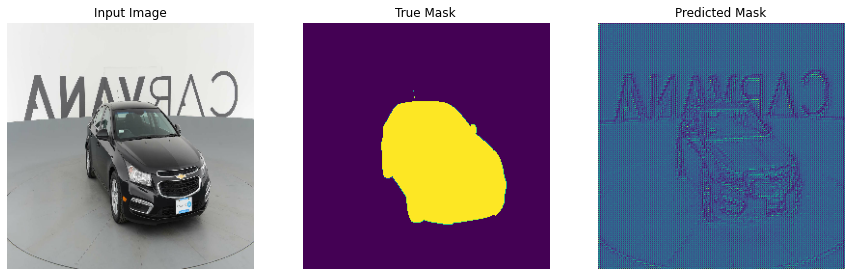

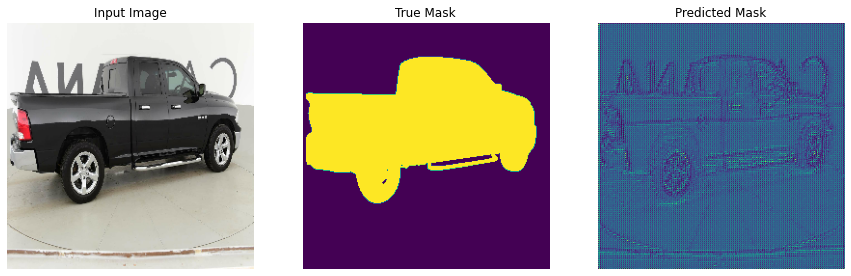

In [35]:
for iter in range(10):
   for image, mask in train.take(iter):
        input_image, true_mask = image, mask
        show_predictions(input_image, true_mask)



In [36]:
model.summary()

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_2 (InputLayer)           [(None, 256, 256, 3  0           []                               
                                )]                                                                
                                                                                                  
 model (Functional)             [(None, 128, 128, 9  1841984     ['input_2[0][0]']                
                                6),                                                               
                                 (None, 64, 64, 144                                               
                                ),                                                                
                                 (None, 32, 32, 192                                         

In [37]:
early_stop = tf.keras.callbacks.EarlyStopping(patience=4,restore_best_weights=True)

In [39]:
class DisplayCallback(tf.keras.callbacks.Callback):
    def on_epoch_begin(self, epoch, logs=None):
        if (epoch + 1) % 3 == 0:
            show_predictions(input_image, true_mask)

In [40]:
EPOCHS = 15
STEPS_PER_EPOCH = TRAIN_LENGTH // BATCH_SIZE

Epoch 1/15
238/238 [==============================] - 426s 2s/step - loss: 0.0654 - dice_coef: 0.9346 - binary_accuracy: 0.9816 - val_loss: 0.0321 - val_dice_coef: 0.9679 - val_binary_accuracy: 0.9890
Epoch 2/15
238/238 [==============================] - 389s 2s/step - loss: 0.0246 - dice_coef: 0.9754 - binary_accuracy: 0.9911 - val_loss: 0.0230 - val_dice_coef: 0.9770 - val_binary_accuracy: 0.9916


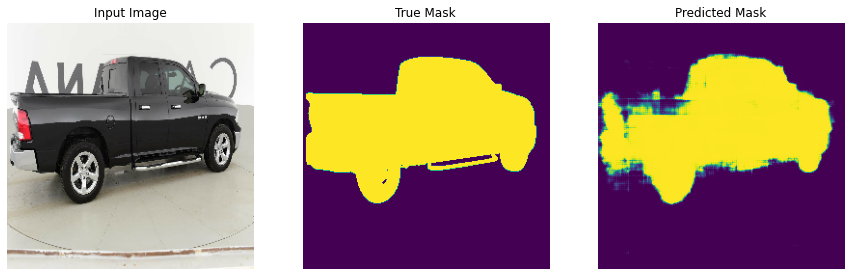

Epoch 3/15
238/238 [==============================] - 390s 2s/step - loss: 0.0218 - dice_coef: 0.9782 - binary_accuracy: 0.9918 - val_loss: 0.0209 - val_dice_coef: 0.9791 - val_binary_accuracy: 0.9921
Epoch 4/15
238/238 [==============================] - 392s 2s/step - loss: 0.0204 - dice_coef: 0.9796 - binary_accuracy: 0.9921 - val_loss: 0.0207 - val_dice_coef: 0.9793 - val_binary_accuracy: 0.9919
Epoch 5/15
238/238 [==============================] - 392s 2s/step - loss: 0.0195 - dice_coef: 0.9805 - binary_accuracy: 0.9923 - val_loss: 0.0194 - val_dice_coef: 0.9806 - val_binary_accuracy: 0.9923


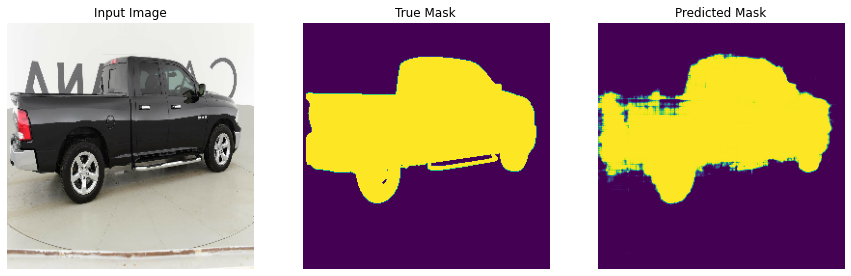

Epoch 6/15
238/238 [==============================] - 391s 2s/step - loss: 0.0189 - dice_coef: 0.9811 - binary_accuracy: 0.9925 - val_loss: 0.0198 - val_dice_coef: 0.9802 - val_binary_accuracy: 0.9921
Epoch 7/15
238/238 [==============================] - 562s 2s/step - loss: 0.0186 - dice_coef: 0.9814 - binary_accuracy: 0.9926 - val_loss: 0.0194 - val_dice_coef: 0.9806 - val_binary_accuracy: 0.9921
Epoch 8/15
238/238 [==============================] - 5030s 21s/step - loss: 0.0181 - dice_coef: 0.9819 - binary_accuracy: 0.9927 - val_loss: 0.0187 - val_dice_coef: 0.9813 - val_binary_accuracy: 0.9925


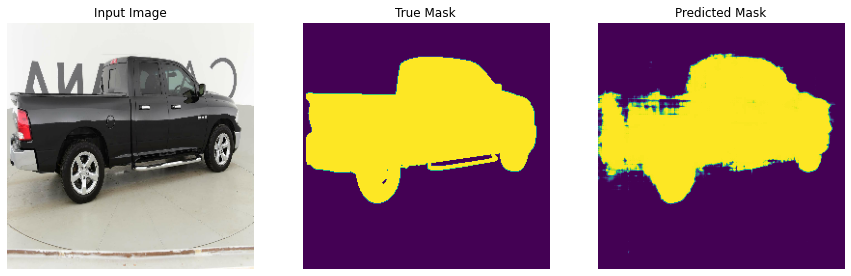

Epoch 9/15
238/238 [==============================] - 424s 2s/step - loss: 0.0178 - dice_coef: 0.9822 - binary_accuracy: 0.9928 - val_loss: 0.0183 - val_dice_coef: 0.9817 - val_binary_accuracy: 0.9926
Epoch 10/15
238/238 [==============================] - 444s 2s/step - loss: 0.0175 - dice_coef: 0.9825 - binary_accuracy: 0.9929 - val_loss: 0.0187 - val_dice_coef: 0.9813 - val_binary_accuracy: 0.9924
Epoch 11/15
238/238 [==============================] - 457s 2s/step - loss: 0.0173 - dice_coef: 0.9827 - binary_accuracy: 0.9929 - val_loss: 0.0189 - val_dice_coef: 0.9811 - val_binary_accuracy: 0.9923


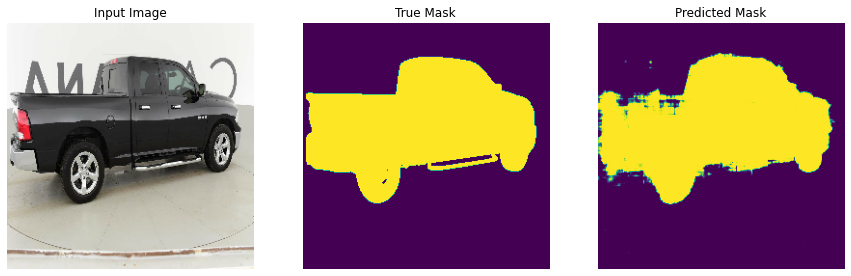

Epoch 12/15
238/238 [==============================] - 427s 2s/step - loss: 0.0172 - dice_coef: 0.9828 - binary_accuracy: 0.9930 - val_loss: 0.0181 - val_dice_coef: 0.9819 - val_binary_accuracy: 0.9926
Epoch 13/15
238/238 [==============================] - 420s 2s/step - loss: 0.0169 - dice_coef: 0.9831 - binary_accuracy: 0.9930 - val_loss: 0.0183 - val_dice_coef: 0.9817 - val_binary_accuracy: 0.9925
Epoch 14/15
238/238 [==============================] - 419s 2s/step - loss: 0.0168 - dice_coef: 0.9832 - binary_accuracy: 0.9931 - val_loss: 0.0176 - val_dice_coef: 0.9824 - val_binary_accuracy: 0.9927


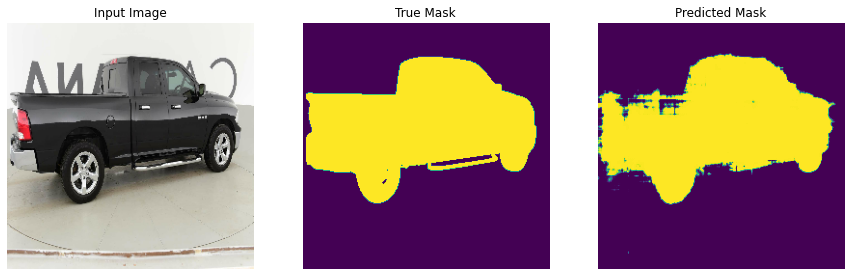

Epoch 15/15
238/238 [==============================] - 390s 2s/step - loss: 0.0166 - dice_coef: 0.9834 - binary_accuracy: 0.9931 - val_loss: 0.0175 - val_dice_coef: 0.9824 - val_binary_accuracy: 0.9928


In [41]:
model_history = model.fit(train_dataset, epochs=EPOCHS,
                          steps_per_epoch=STEPS_PER_EPOCH,
                          validation_data=valid_dataset,
                          callbacks=[DisplayCallback(), early_stop])